## Задание 1

### Задача 1.1

In [167]:
import pandas as pd
df= pd.read_csv('kc_house_data.csv')
df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


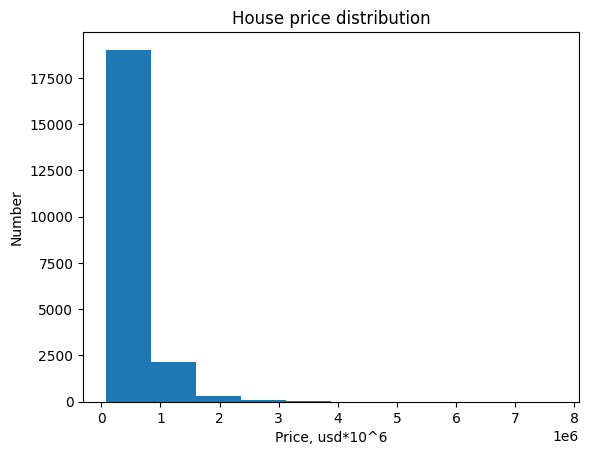

In [168]:
import matplotlib.pyplot as plt

plt.hist(df['price'])
plt.title('House price distribution')
plt.xlabel('Price, usd*10^6');
# как пправило, в гистограммах не называют ось y, т.к. это почти всегда количество данных. 
plt.ylabel('Number');

### Задача 1.2

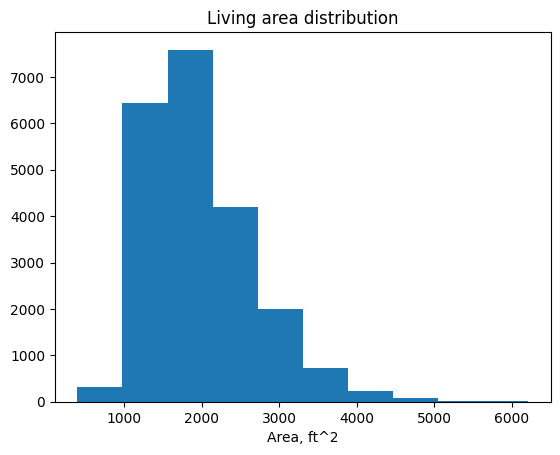

In [169]:
plt.hist(df['sqft_living15'])
plt.title('Living area distribution')
plt.xlabel('Area, ft^2');

### Задача 1.3

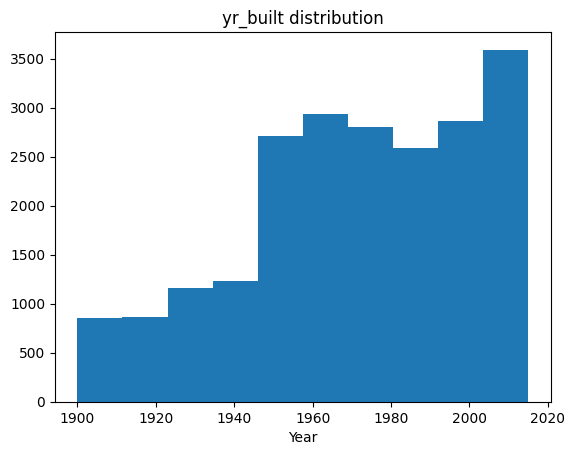

In [170]:
plt.hist(df['yr_built'])
plt.title('yr_built distribution')
plt.xlabel('Year');

## Задание 2

### Задача 2.1

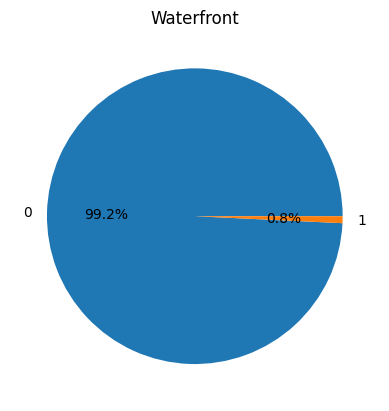

In [171]:
data = df['waterfront'].value_counts()
data
plt.pie(data.values, labels=data.index, autopct='%.1f%%')
plt.title('Waterfront');

### Задача 2.2

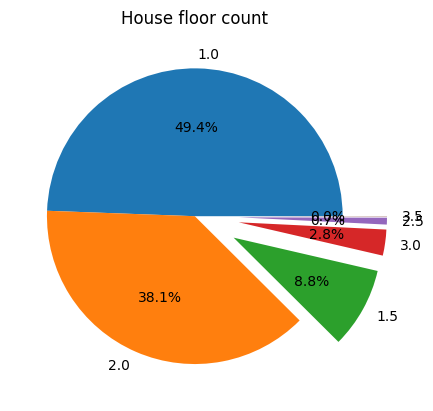

In [172]:
data = df['floors'].value_counts()
data
explode=[0,0,0.3,0.3,0.3,0.3]
plt.pie(data.values, labels=data.index, explode=explode, autopct='%.1f%%')
plt.title('House floor count');

### Задача 2.3

condition
3    14031
4     5679
5     1701
2      172
1       30
Name: count, dtype: int64


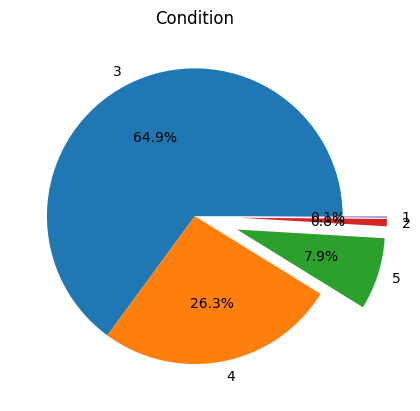

In [173]:
data = df['condition'].value_counts()
print(data)
explode=[0,0,0.3,0.3,0.3]
plt.pie(data.values, labels=data.index, explode=explode, autopct='%.1f%%')
plt.title('Condition');


## Задание 3

In [180]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   date           21613 non-null  object 
 2   price          21613 non-null  float64
 3   bedrooms       21613 non-null  int64  
 4   bathrooms      21613 non-null  float64
 5   sqft_living    21613 non-null  int64  
 6   sqft_lot       21613 non-null  int64  
 7   floors         21613 non-null  float64
 8   waterfront     21613 non-null  int64  
 9   view           21613 non-null  int64  
 10  condition      21613 non-null  int64  
 11  grade          21613 non-null  int64  
 12  sqft_above     21613 non-null  int64  
 13  sqft_basement  21613 non-null  int64  
 14  yr_built       21613 non-null  int64  
 15  yr_renovated   21613 non-null  int64  
 16  zipcode        21613 non-null  int64  
 17  lat            21613 non-null  float64
 18  long  

Для выявления факторов влияния на цену недвижимости, была построена матрица корреляций.

In [187]:
import numpy as np
df=df.drop(columns=['sqft_living15', 'sqft_lot15', 'date'])
# лишние колонки убрал, дату убрал т.к. не хочет с ней строить матрицу корреляций и вообще я не знаю это дата чего
corr_matrix = df.corr()
corr_matrix = np.round(corr_matrix, 1)
corr_matrix[np.abs(corr_matrix) < 0.3] = 0
corr_matrix


,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long
id,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
price,0.0,1.0,0.3,0.5,0.7,0.0,0.3,0.3,0.4,0.0,0.7,0.6,0.3,0.0,0.0,0.0,0.3,0.0
bedrooms,0.0,0.3,1.0,0.5,0.6,0.0,0.0,0.0,0.0,0.0,0.4,0.5,0.3,0.0,0.0,0.0,0.0,0.0
bathrooms,0.0,0.5,0.5,1.0,0.8,0.0,0.5,0.0,0.0,0.0,0.7,0.7,0.3,0.5,0.0,0.0,0.0,0.0
sqft_living,0.0,0.7,0.6,0.8,1.0,0.0,0.4,0.0,0.3,0.0,0.8,0.9,0.4,0.3,0.0,0.0,0.0,0.0
sqft_lot,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
floors,0.0,0.3,0.0,0.5,0.4,0.0,1.0,0.0,0.0,-0.3,0.5,0.5,0.0,0.5,0.0,0.0,0.0,0.0
waterfront,0.0,0.3,0.0,0.0,0.0,0.0,0.0,1.0,0.4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
view,0.0,0.4,0.0,0.0,0.3,0.0,0.0,0.4,1.0,0.0,0.3,0.0,0.3,0.0,0.0,0.0,0.0,0.0
condition,0.0,0.0,0.0,0.0,0.0,0.0,-0.3,0.0,0.0,1.0,0.0,0.0,0.0,-0.4,0.0,0.0,0.0,0.0


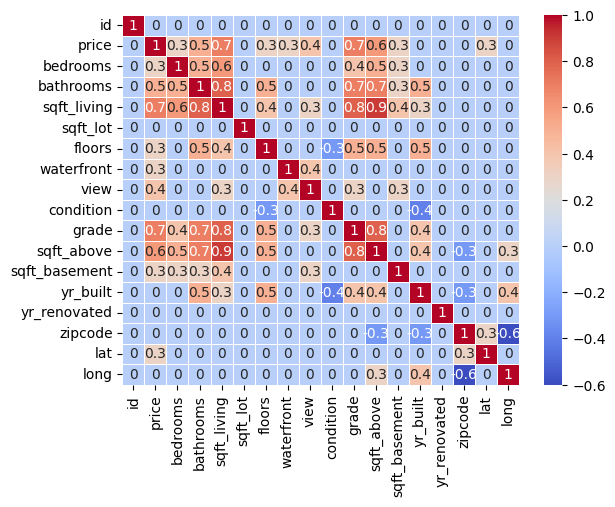

In [188]:
import seaborn as sb
sb.heatmap(corr_matrix, annot=True, linewidths=.5, cmap='coolwarm');

Из таблицы видно, что есть сильная корреляция цены с оценкой дома и площадью недвижимости (строить графики для каждой колонки с площадью некорректно, т.к. эти признаки связаны между собой, так что я построил одну). Слабая связь есть между ценой и количеством спален, ванных и видом.

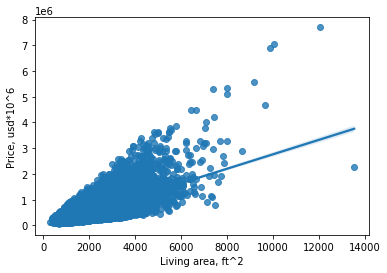

In [ ]:
sb.regplot(x=df['sqft_living'], y=df['price'],fit_reg=True)
plt.xlabel('Living area, ft^2');
plt.ylabel('Price, usd*10^5');
plt.show()

Стоисмость домов увеличивается вместе с ростом их жилой площади, что логично, стоит отметить выброс в правой нижней части графика. 

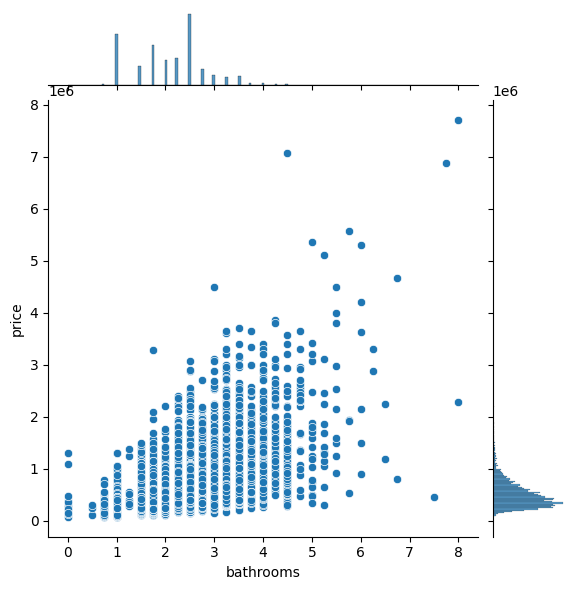

In [ ]:
import seaborn as sb
sb.jointplot(x='bathrooms', y='price', data=df, kind='scatter');

Чем больше в доме ванных комнат тем больше его цена, но зависимость слабая

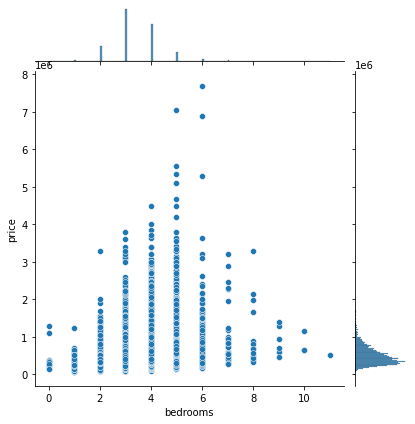

In [ ]:
sb.jointplot(x='bedrooms', y='price', data=df[df.bedrooms<15], kind='scatter');

Не наблюдается зависимости цены от количества спален, что, как по мне, странно. Богачи любят мыться но не спать?

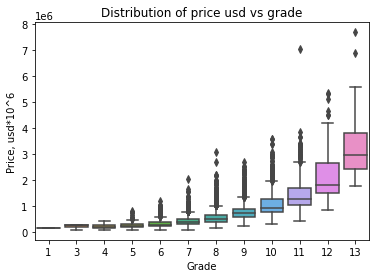

In [ ]:
sb.boxplot(x=df['grade'], y=df['price'], whis=1.5)

plt.xlabel('Grade')
plt.ylabel('Price, usd*10^6')
plt.title('Distribution of price usd vs grade');

Ожидаемо, что оценка дома растет вместе с его ценой. Из графика видно, что диапозоны возможных значений для соседних групп пересекаются, т.е. цена домов в соседних группах статистически значимо не отличается.  

In [ ]:
df['price'].describe()

count    2.161300e+04
mean     5.400881e+05
std      3.671272e+05
min      7.500000e+04
25%      3.219500e+05
50%      4.500000e+05
75%      6.450000e+05
max      7.700000e+06
Name: price, dtype: float64

In [ ]:
import folium
this_map = folium.Map(prefer_canvas=True)
def color_change(price):
    if (price > 1000000):
        return ('red')
    elif(300000<=price<1000000):
        return ('green')
    else:
        return('blue')
def plotDot(point):
    folium.CircleMarker(location=[point.lat, point.long],
                       radius=2,
                       popup=[point.price, point.floors], color=color_change(point.price)).add_to(this_map)
    
df.apply(plotDot, axis=1)
this_map.fit_bounds(this_map.get_bounds())
this_map

Как отмечено на карте, дорогая недвижимость находится в центре городов, особенно много таких домов у побережья, также дорогие дома находятся рядом с парками. Наиболее дешевая недвижимость расположена на юге от Сиэтла. Такая цена обусловлена близостью к аэропорту и железной дороге, а также отсутствием городской инфраструктуры (я бывал в Сиэтле).